In [26]:
import os 
import gc
import timm
import copy
import torch
import random as rd 
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
from tqdm import tqdm
import matplotlib.pyplot as plt

import albumentations as A
from albumentations.pytorch import ToTensorV2

In [27]:
device = torch.device("cuda" if torch.cuda.is_available() else "mps" if torch.backends.mps.is_available() else "cpu")
print("Using device: ", device)

Using device:  cuda


In [28]:
# Set seeds for reproducibility
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
rd.seed(seed)
torch.cuda.manual_seed_all(seed)

# Enable deterministic behavior in PyTorch
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [29]:
transform_input = A.Compose([
    A.Resize(40,45),
    ToTensorV2()
])

transform_target = A.Compose([
    A.Resize(160,180),
    ToTensorV2()
])

In [30]:
train_directory = "/kaggle/input/coco-2017-dataset/coco2017/train2017"
val_directory   = "/kaggle/input/coco-2017-dataset/coco2017/val2017"
test_directory  = "/kaggle/input/coco-2017-dataset/coco2017/test2017"

train_images = os.listdir(train_directory)
val_images   = os.listdir(val_directory)
test_images  = os.listdir(test_directory)

train_filenames = [f for f in train_images if f.endswith('.jpg')]
val_filenames   = [f for f in val_images if f.endswith('.jpg')]
test_filenames  = [f for f in test_images if f.endswith('.jpg')]

train_filenames[:3]

['000000501175.jpg', '000000094632.jpg', '000000276721.jpg']

In [31]:
class DatasetFromjpgs(Dataset):
    def __init__(self, filenames, dir_path, transform_input=None, transform_target=None, subset_size=None):
        self.filenames = filenames
        self.transform_input = transform_input
        self.transform_target = transform_target
        self.dir_path = dir_path
        
        if subset_size is not None and subset_size < len(filenames):
            self.filenames = rd.sample(filenames, k=subset_size)
        else:
            self.filenames = filenames

    def __len__(self):
        return len(self.filenames)

    def __getitem__(self, index):
        img_path = os.path.join(self.dir_path, self.filenames[index])
        image = Image.open(img_path).convert('RGB')

        # Crop the image to (160, 180)
        width, height = image.size
        
        if (width < 180) or (height < 160) :
            img_path = os.path.join(self.dir_path, self.filenames[0])
            image = Image.open(img_path).convert('RGB')
            width, height = image.size
            
        left = max(0, (width - 180) // 2)
        top = max(0, (height - 160) // 2)
        right = min(width, left + 180)
        bottom = min(height, top + 160)

        image = image.crop((left, top, right, bottom))
        image = np.array(image).astype(np.float32)
        image /= 255.0

        transformed_input = self.transform_input(image=image)
        transformed_output = self.transform_target(image=image)
        shrinked_image = transformed_input['image']
        original_image = transformed_output['image']

        return shrinked_image, original_image



In [32]:
subset_size = 25_600
train_dataset = DatasetFromjpgs(filenames=train_filenames, dir_path=train_directory, transform_input=transform_input, transform_target=transform_target, subset_size = subset_size)
val_dataset   = DatasetFromjpgs(filenames=val_filenames,   dir_path=val_directory,   transform_input=transform_input, transform_target=transform_target, subset_size = int(subset_size * 0.1))
test_dataset  = DatasetFromjpgs(filenames=test_filenames,  dir_path=test_directory,  transform_input=transform_input, transform_target=transform_target, subset_size = int(subset_size * 0.1))

In [33]:
# Define DataLoader for each set
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset, batch_size=batch_size,   shuffle=True, num_workers=4)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

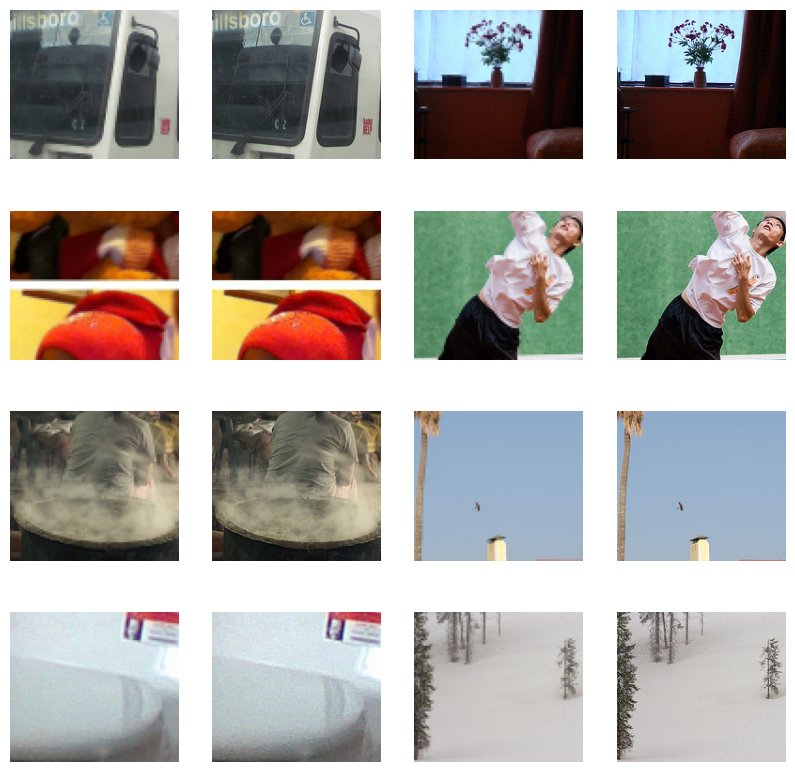

In [34]:
plt.figure(figsize=(10, 10))
for i in range(8):
    index = rd.randint(0, len(test_dataset) - 1)
    
    shrinked_image, original_image = test_dataset[index]
    if isinstance(shrinked_image, torch.Tensor):
        shrinked_image = shrinked_image.permute(1, 2, 0).numpy()
    if isinstance(original_image, torch.Tensor):
        original_image = original_image.permute(1, 2, 0).numpy()
        
    plt.subplot(4, 4, 2*i+1)   
    plt.imshow(shrinked_image)
    plt.axis('off')
    
    plt.subplot(4, 4, 2*i+2)
    plt.imshow(original_image)
    plt.axis('off')

plt.show()

In [35]:
def plot_original_and_predicted_images(original_images, shrinked_images, predicted_images, num_images=4):
    plt.figure(figsize=(12, num_images * 5))
    
    for i in range(num_images):
        # Plot input image
        plt.subplot(num_images, 3, i * 3 + 1)
        shrinked_image = shrinked_images[i].permute(1, 2, 0).cpu().numpy()  # Convert tensor to NumPy array and adjust channels
        plt.imshow(shrinked_image)
        plt.axis('off')
        plt.title("Srinked Image")
        
        # Plot predicted image
        plt.subplot(num_images, 3, i * 3 + 2)
        predicted_image = predicted_images[i].detach().permute(1, 2, 0).cpu().numpy()  # Detach the tensor and convert to NumPy array
        plt.imshow(predicted_image)
        plt.axis('off')
        plt.title("Predicted Image")

        # Plot original image
        plt.subplot(num_images, 3, i * 3 + 3)
        original_image = original_images[i].permute(1, 2, 0).cpu().numpy()  # Convert tensor to NumPy array and adjust channels
        plt.imshow(original_image)
        plt.axis('off')
        plt.title("Original Image")    
    plt.tight_layout()
    plt.show()


In [36]:
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(channels)
        self.relu1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(channels)
        self.relu2 = nn.ReLU(inplace=True)

    def forward(self, x):
        identity = x
        out = self.relu1(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += identity
        out = self.relu2(out)
        return out


In [37]:
class Expander(nn.Module):
    def __init__(self):
        super(Expander, self).__init__()

        # Initial feature extraction block
        self.conv1 = nn.Conv2d(3, 64, kernel_size=5, padding=2)
        self.relu1 = nn.ReLU(inplace=True)

        # Residual blocks to deepen the network
        self.resblock1 = ResidualBlock(64)
        self.resblock2 = ResidualBlock(64)
        self.resblock3 = ResidualBlock(64)

        # Upsample the feature maps
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)

        # Another block after upsampling
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.relu2 = nn.ReLU(inplace=True)

        self.resblock4 = ResidualBlock(64)
        self.resblock5 = ResidualBlock(64)

        # Final layer to output the 3-channel image
        self.conv3 = nn.Conv2d(64, 3, kernel_size=3, padding=1)
        self.sigmoid = nn.Sigmoid()  # Ensure output is between 0 and 1 for valid image pixel values

    def forward(self, x):
        # Initial convolution
        x = self.relu1(self.conv1(x))

        # Pass through residual blocks
        x = self.resblock1(x)
        x = self.resblock2(x)
        x = self.resblock3(x)

        # Upsample the feature maps
        x = self.upsample(x)

        # Continue feature extraction and residual blocks after upsampling
        x = self.relu2(self.conv2(x))
        x = self.resblock4(x)
        x = self.resblock5(x)

        # Output layer
        x = self.conv3(x)
        x = self.sigmoid(x)  # Apply sigmoid to constrain output between 0 and 1

        return x

In [38]:
def criterion(outputs, targets):
    loss = nn.MSELoss()(outputs, targets)
    return loss

In [39]:
from sklearn.metrics import accuracy_score, recall_score
from torch.nn.functional import softmax

def train_one_epoch(expander_model, optimizer, scheduler, dataloader, device, epoch):
    expander_model.train()
    
    dataset_size = 0
    running_loss = 0.0
    
    bar = tqdm(enumerate(dataloader), total=len(dataloader))
    for step, (shrinked_images, original_images) in bar:
        shrinked_images = shrinked_images.to(device, dtype=torch.float)
        original_images = original_images.to(device, dtype=torch.float)

        batch_size = shrinked_images.size(0)

        # Forward pass
        predicted_images = expander_model(shrinked_images)       

        # Compute the loss
        loss = criterion(predicted_images, original_images)

        # Zero the parameter gradients
        optimizer.zero_grad()
    
        # Backward pass
        loss.backward()

        torch.nn.utils.clip_grad_norm_(expander_model.parameters(), max_norm=1.0)

        # Update the optimizer
        optimizer.step()

        running_loss += (loss.item() * batch_size)
        dataset_size += batch_size

        epoch_loss = running_loss / dataset_size            
        bar.set_postfix(Epoch=epoch, Train_Loss=epoch_loss)

    # plot_original_and_predicted_images(original_images[:4], shrinked_images[:4], predicted_images[:4])

    return epoch_loss

In [40]:
# Disabling gradient computation and saving memory
@torch.inference_mode()
def valid_one_epoch(expander_model, dataloader, device, epoch):    
    dataset_size = 0
    running_loss = 0.0
    
    bar = tqdm(enumerate(dataloader), total=len(dataloader))
    for step, (shrinked_images, original_images) in bar: 
        shrinked_images = shrinked_images.to(device, dtype=torch.float)
        original_images = original_images.to(device, dtype=torch.float)

        batch_size = shrinked_images.size(0)
        predicted_images = expander_model(shrinked_images)       

        # Compute the loss
        loss = criterion(predicted_images, original_images)

        running_loss += (loss.item() * batch_size)
        dataset_size += batch_size

        epoch_loss = running_loss / dataset_size

        bar.set_postfix(Epoch=epoch, Train_Loss=epoch_loss)
        
    plot_original_and_predicted_images(original_images[:4], shrinked_images[:4], predicted_images[:4])
        
    return epoch_loss


In [41]:
import time

def run_training(expander_model, optimizer, scheduler, device, num_epochs):
    # Confirm that it is running on GPU
    if torch.cuda.is_available():
        print("[INFO] Using GPU: {}\n".format(torch.cuda.get_device_name()))
    
    start = time.time()
    
    # Deep copies the initial model weights to save the best model later
    best_model_wts = copy.deepcopy(expander_model.state_dict())
    
    # Initializes the best ACC to 0.
    best_epoch_loss = 0
    
    # Initializa dictionary (Better way than history = {} because history['Train Loss'].append(train_epoch_loss) is possible even is 'Train Loss' isn't a key yet)
    history = defaultdict(list)
    
    for epoch in range(1, num_epochs + 1): 
        
        print(f"EPOCH [{epoch}/{num_epochs}]")
        
        # Train for one epoch
        train_epoch_loss = train_one_epoch(expander_model, optimizer, scheduler, 
                                           dataloader=train_loader, 
                                           device=device, epoch=epoch)
        # Valid for one epoch
        val_epoch_loss = valid_one_epoch(expander_model, val_loader, device=device, 
                                         epoch=epoch)
        
        # Save the loss and score in the history dict
        history['Train Loss'].append(train_epoch_loss)
        history['Valid Loss'].append(val_epoch_loss)
        history['lr'].append(optimizer.param_groups[0]['lr'])
        
        # Save the model if it's getting better results
        if best_epoch_loss >= val_epoch_loss:
            print(f"{best_epoch_loss} Validation AUROC Improved ({best_epoch_loss} ---> {val_epoch_loss})")
            
            best_epoch_loss = val_epoch_loss
            
            # Deepcopy the weights
            best_model_wts = copy.deepcopy(expander_model.state_dict())
            
            # Saves the weights in the working directory
            PATH = "Loss_{:.4f}_epoch{:.0f}.bin".format(val_epoch_loss, epoch)
            torch.save(expander_model.state_dict(), PATH)
            
            print(f"Model Saved")
            
        print()

        scheduler.step(train_epoch_loss)
    
    end = time.time()
    
    # Display the training time
    time_elapsed = end - start # in seconds
    print('Training complete in {:.0f}h {:.0f}m {:.0f}s'.format(
        time_elapsed // 3600 , (time_elapsed % 3600) // 60, (time_elapsed % 3600) % 60))
    print("Best LOSS: {:.2%}".format(best_epoch_loss))
    
    # load best model weights
    expander_model.load_state_dict(best_model_wts)
    
    return expander_model, history

In [42]:
def initialize_weights(m):
    if isinstance(m, nn.Conv2d):
        nn.init.xavier_normal_(m.weight)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

In [43]:
high_resolution_model = Expander().to(device)
high_resolution_model.apply(initialize_weights)

Expander(
  (conv1): Conv2d(3, 64, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (relu1): ReLU(inplace=True)
  (resblock1): ResidualBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
  )
  (resblock2): ResidualBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
  )
  (resbl

In [44]:
optimizer = torch.optim.Adam(high_resolution_model.parameters(), lr=1e-4)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, verbose=True)

[INFO] Using GPU: Tesla P100-PCIE-16GB

EPOCH [1/20]


100%|██████████| 80/80 [00:07<00:00, 10.17it/s, Epoch=1, Train_Loss=0.0057] 


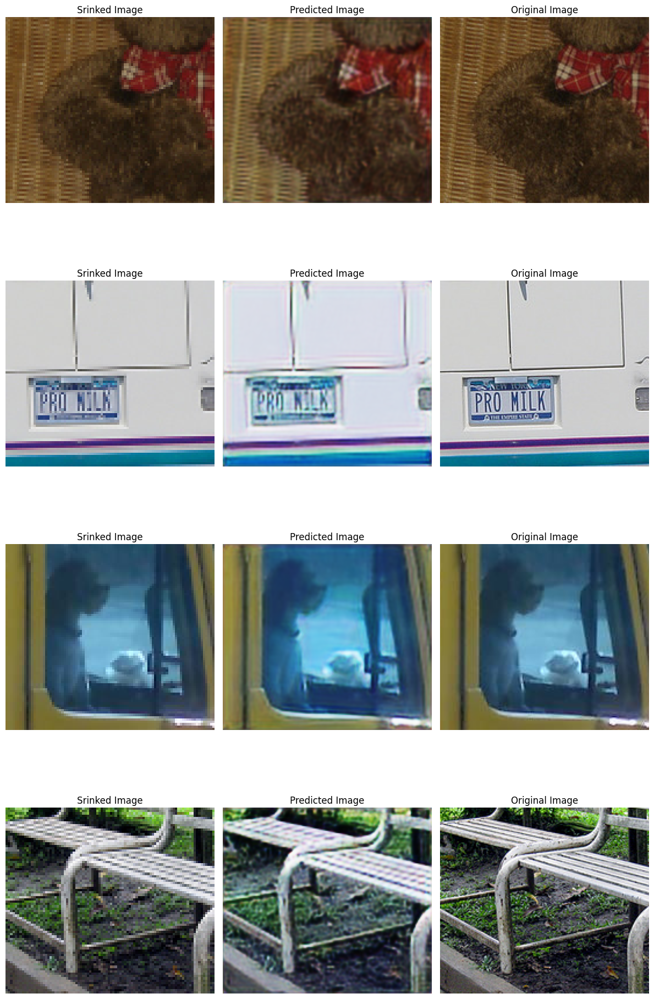


EPOCH [2/20]


100%|██████████| 80/80 [00:07<00:00, 10.51it/s, Epoch=2, Train_Loss=0.00429]


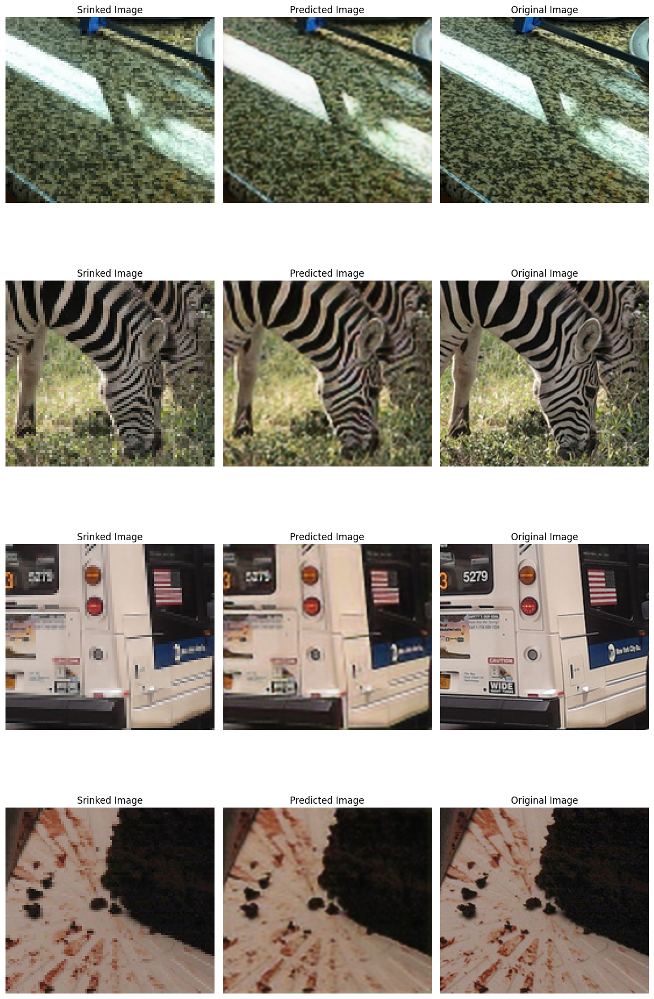


EPOCH [3/20]


100%|██████████| 80/80 [00:07<00:00, 11.00it/s, Epoch=3, Train_Loss=0.00411]


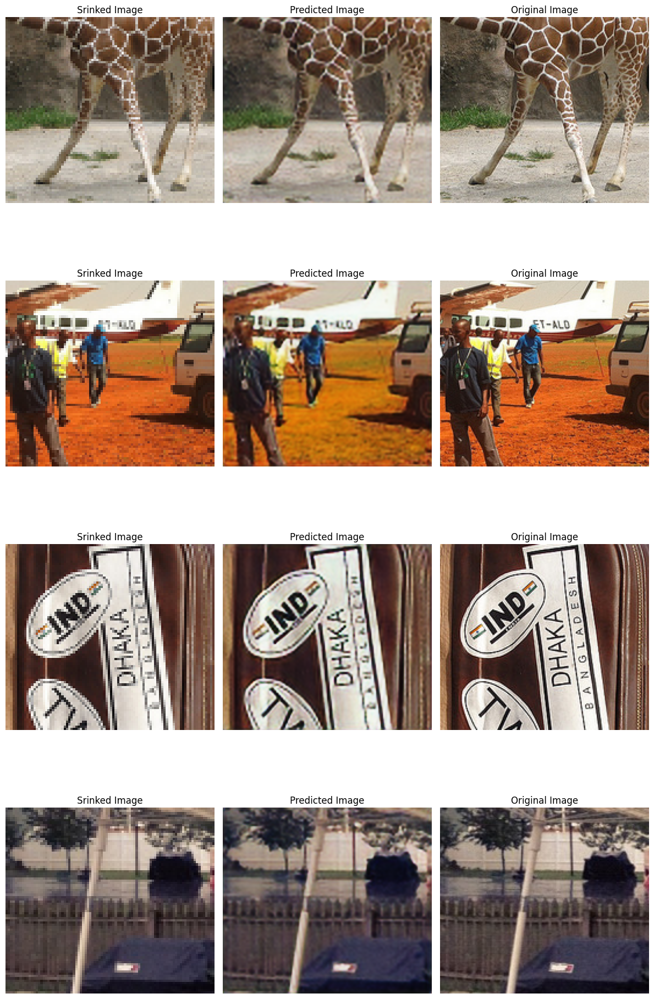


EPOCH [4/20]


100%|██████████| 80/80 [00:07<00:00, 11.26it/s, Epoch=4, Train_Loss=0.00369]


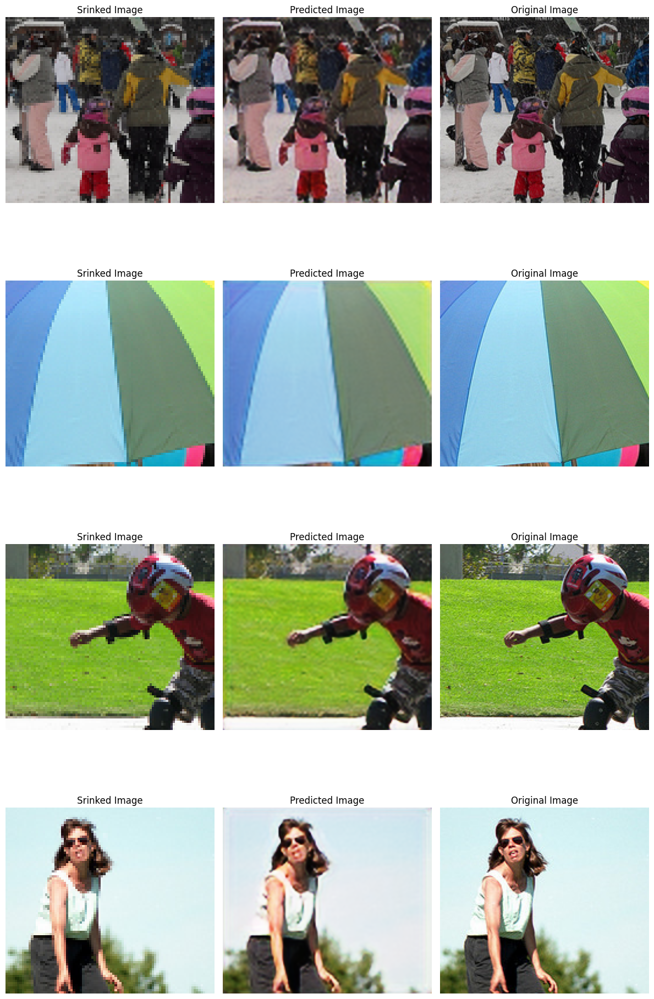


EPOCH [5/20]


100%|██████████| 80/80 [00:07<00:00, 11.30it/s, Epoch=5, Train_Loss=0.00363]


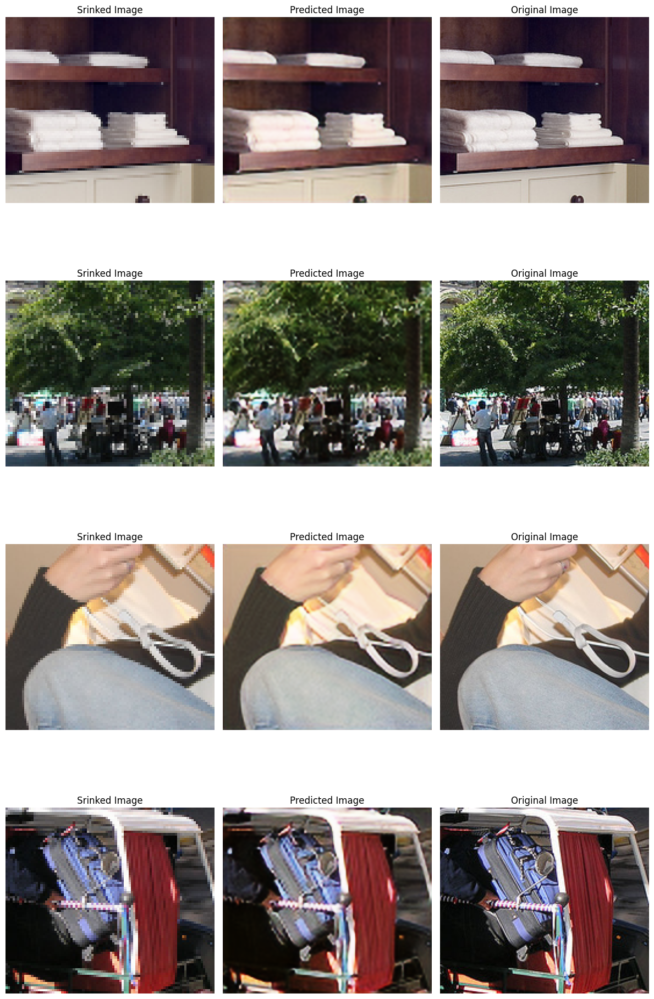


EPOCH [6/20]


100%|██████████| 80/80 [00:07<00:00, 11.19it/s, Epoch=6, Train_Loss=0.00355]


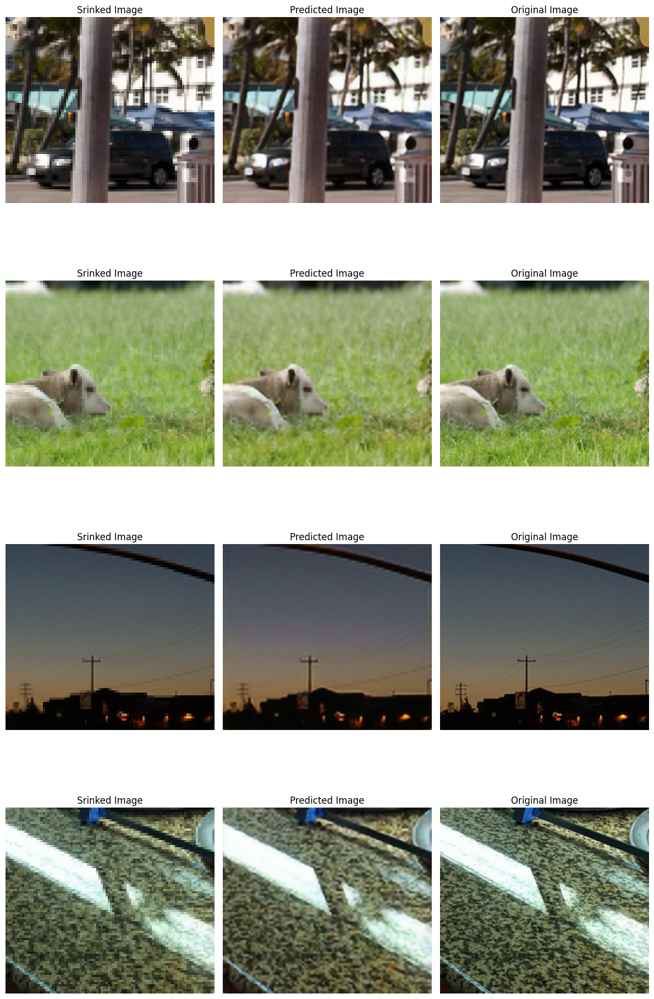


EPOCH [7/20]


100%|██████████| 80/80 [00:07<00:00, 10.53it/s, Epoch=7, Train_Loss=0.00339]


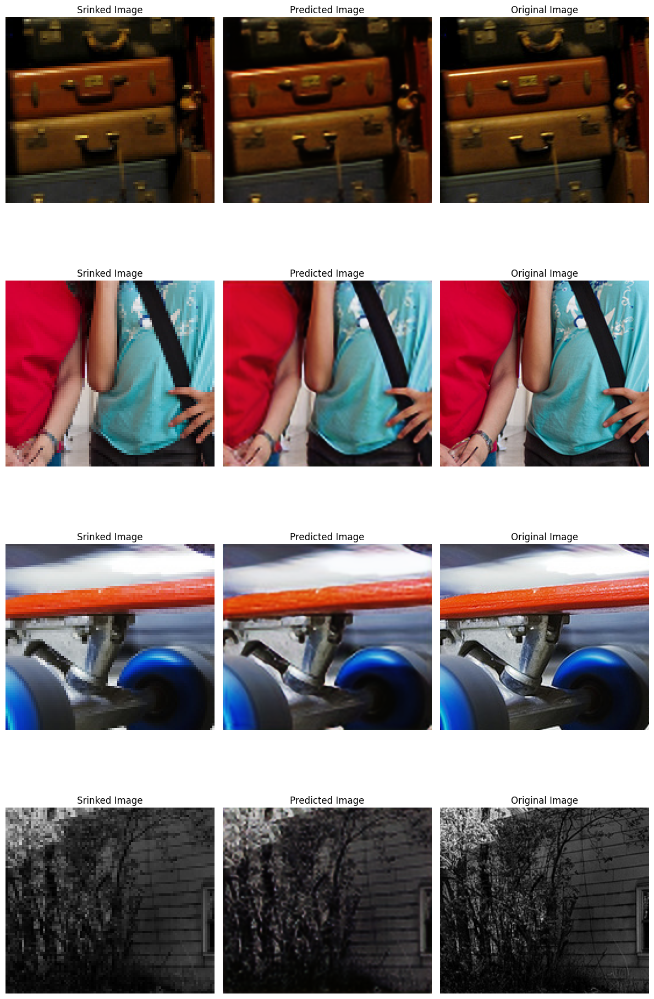


EPOCH [8/20]


100%|██████████| 80/80 [00:07<00:00, 11.32it/s, Epoch=8, Train_Loss=0.0033] 


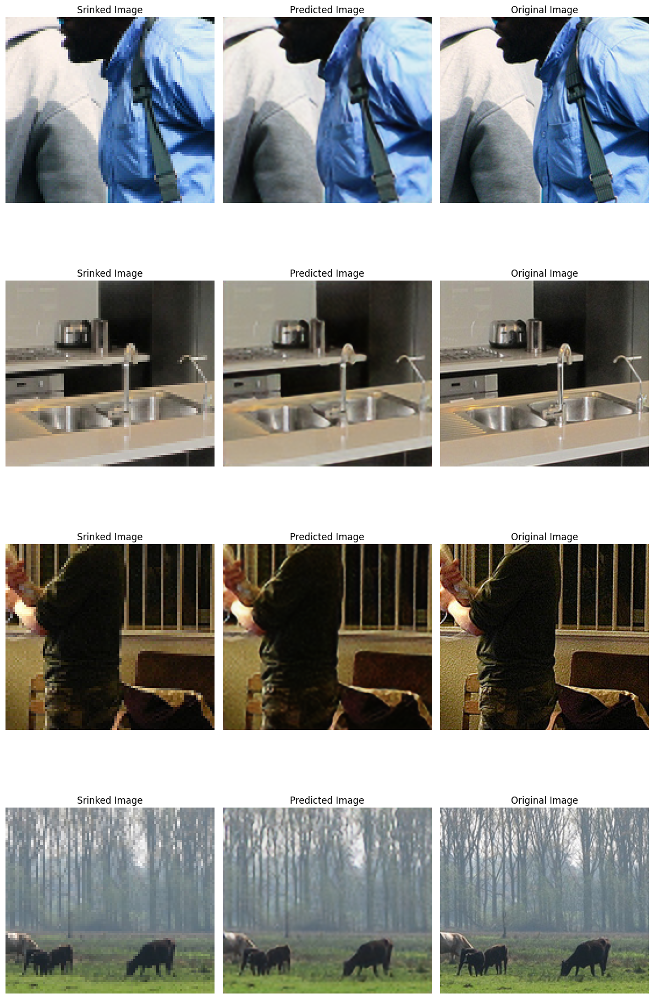


EPOCH [9/20]


100%|██████████| 80/80 [00:06<00:00, 11.45it/s, Epoch=9, Train_Loss=0.0032] 


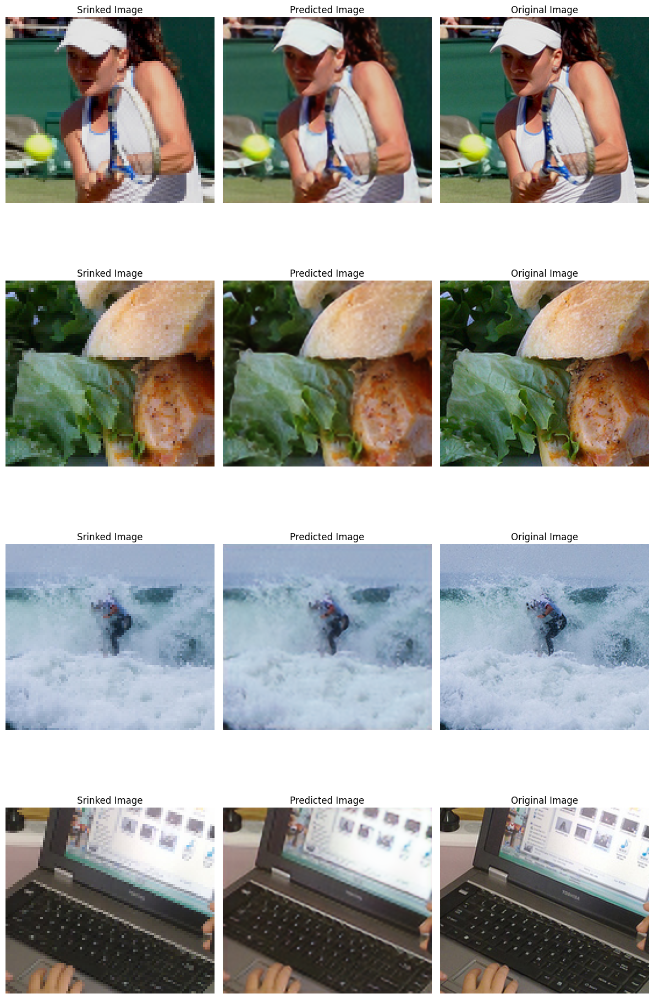


EPOCH [10/20]


100%|██████████| 80/80 [00:06<00:00, 11.49it/s, Epoch=10, Train_Loss=0.00322]


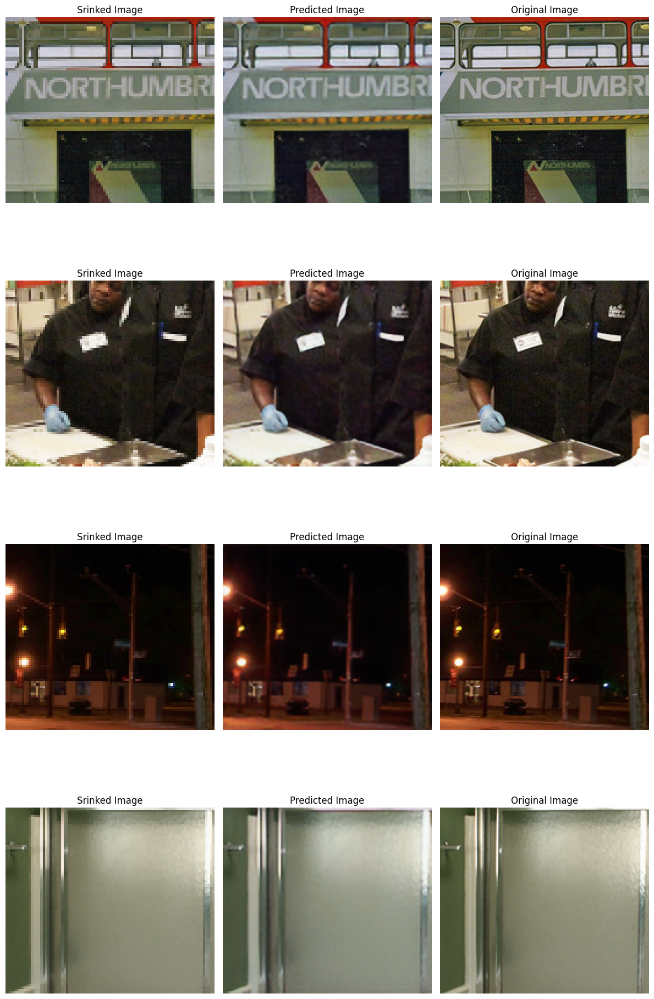


EPOCH [11/20]


100%|██████████| 80/80 [00:06<00:00, 11.51it/s, Epoch=11, Train_Loss=0.0031] 


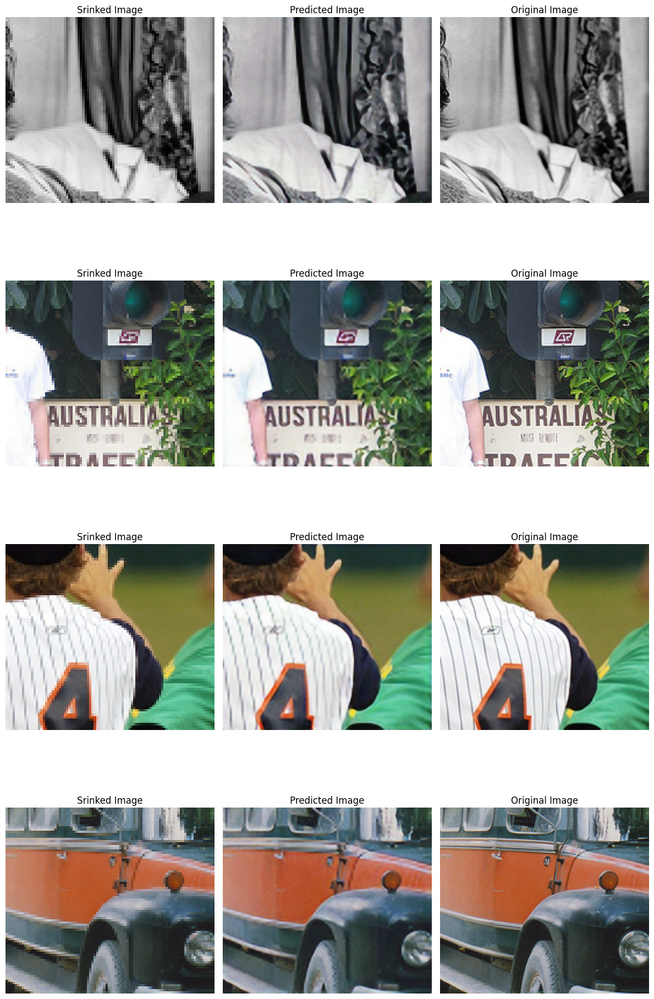


EPOCH [12/20]


100%|██████████| 80/80 [00:06<00:00, 11.52it/s, Epoch=12, Train_Loss=0.00305]


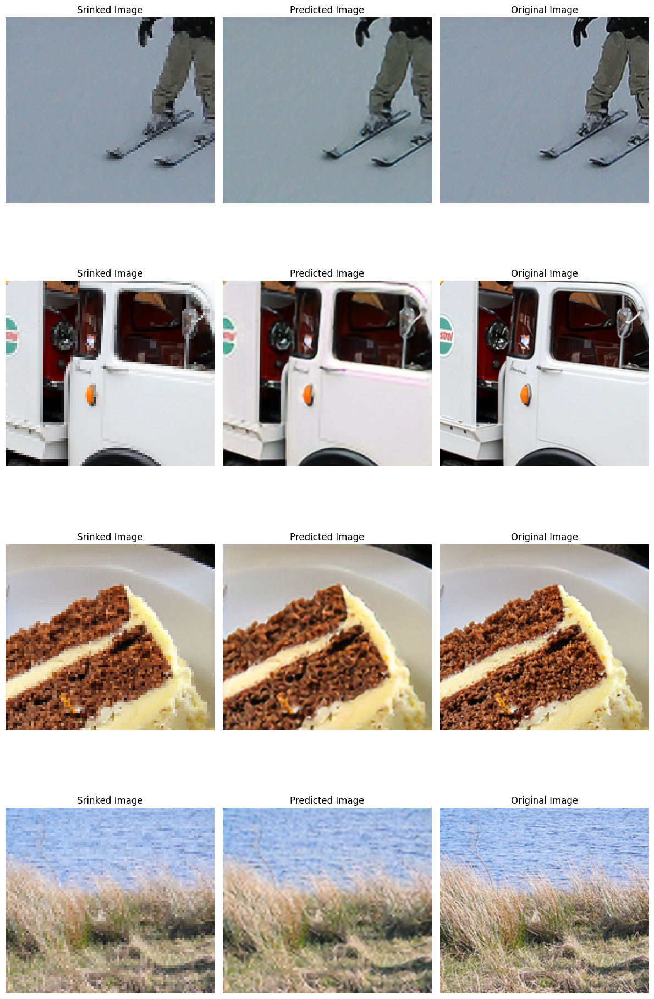


EPOCH [13/20]


100%|██████████| 80/80 [00:07<00:00, 10.72it/s, Epoch=13, Train_Loss=0.0031] 


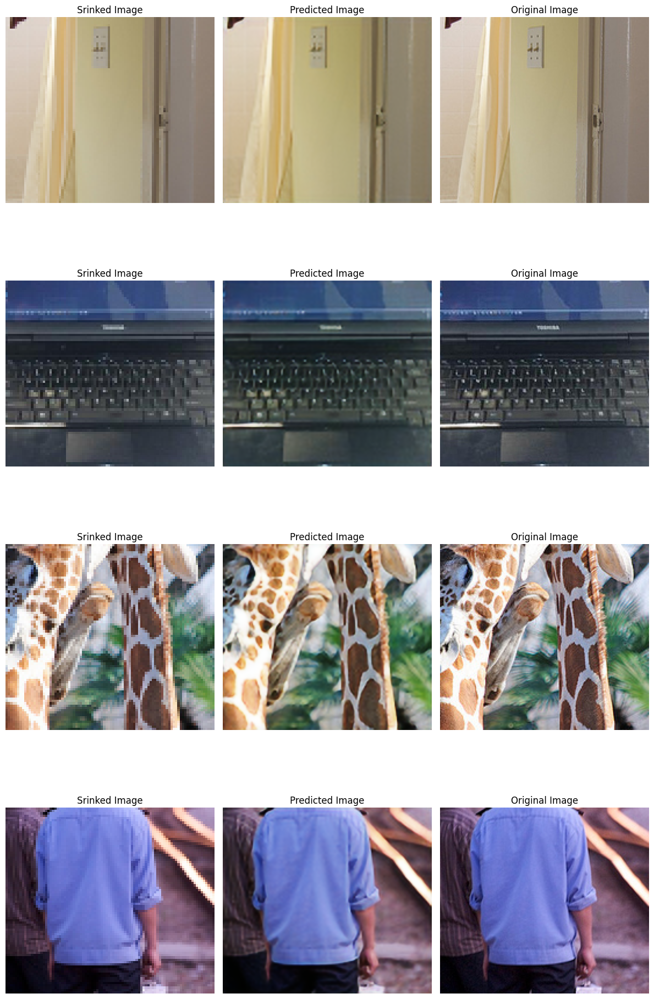


EPOCH [14/20]


100%|██████████| 80/80 [00:06<00:00, 11.64it/s, Epoch=14, Train_Loss=0.00293]


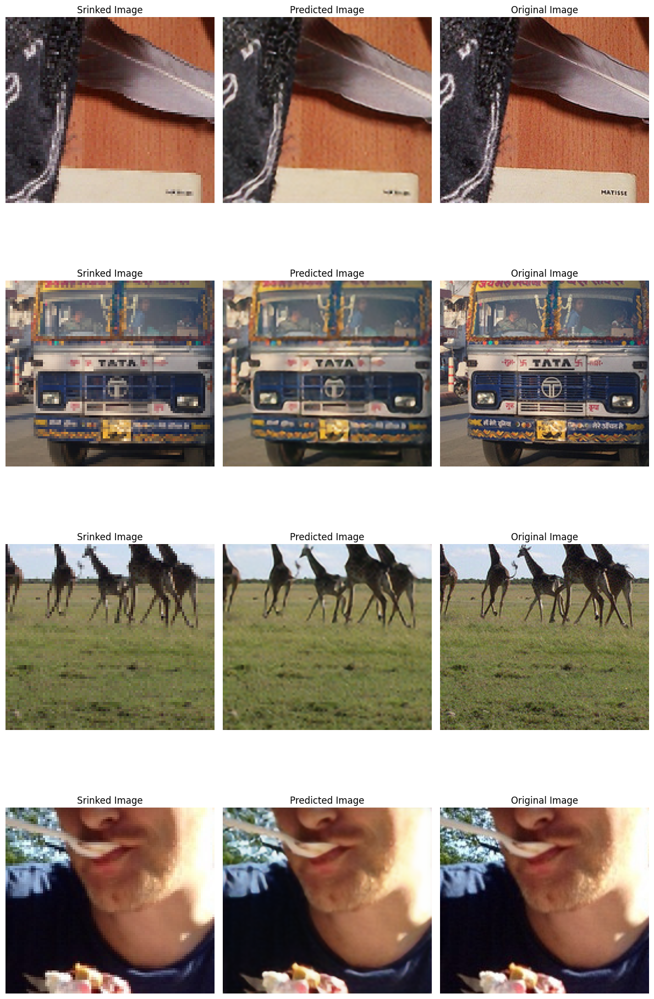


EPOCH [15/20]


100%|██████████| 80/80 [00:06<00:00, 11.68it/s, Epoch=15, Train_Loss=0.00301]


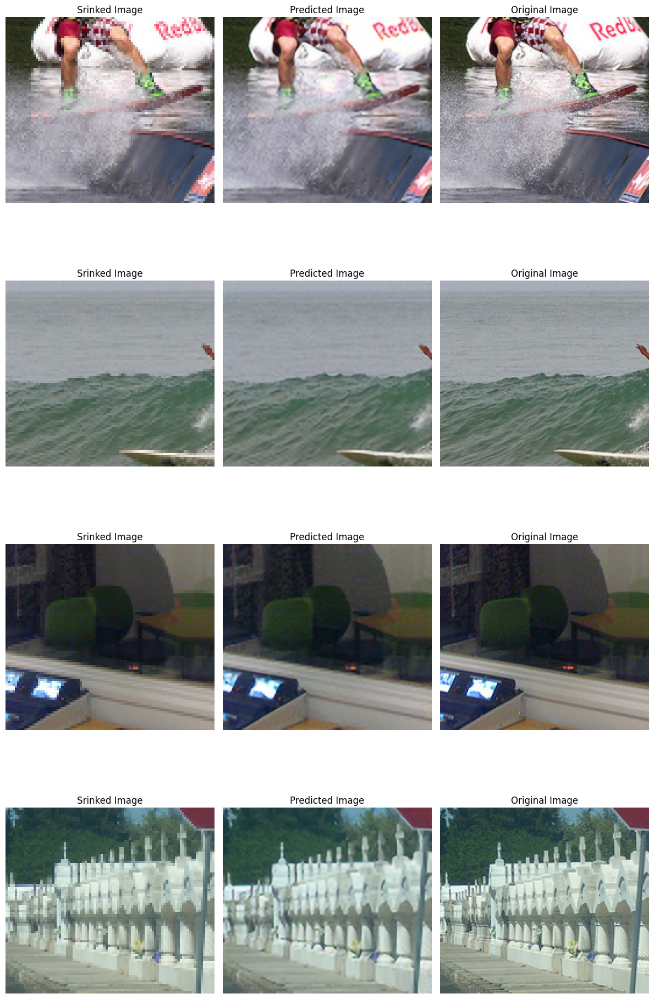


EPOCH [16/20]


100%|██████████| 80/80 [00:07<00:00, 10.74it/s, Epoch=16, Train_Loss=0.00297]


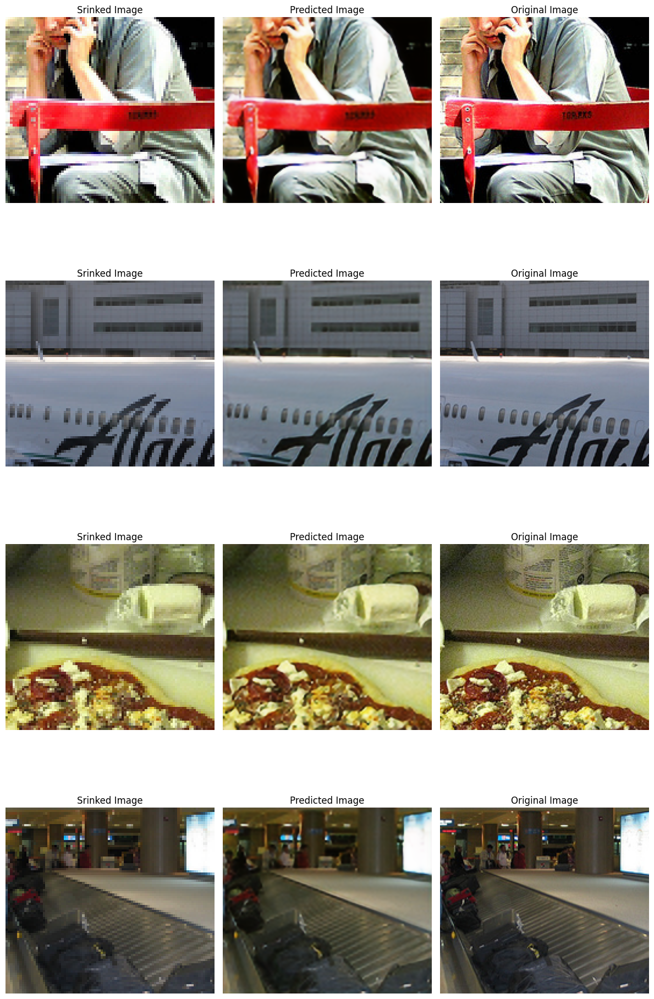


EPOCH [17/20]


100%|██████████| 80/80 [00:07<00:00, 10.57it/s, Epoch=17, Train_Loss=0.00287]


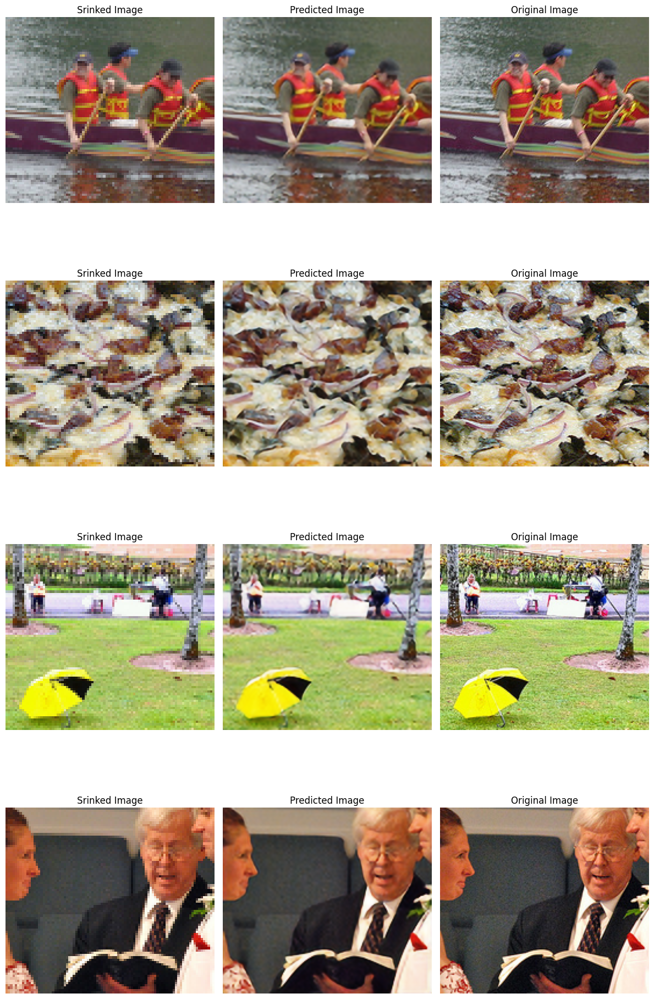


EPOCH [18/20]


100%|██████████| 80/80 [00:08<00:00,  9.94it/s, Epoch=18, Train_Loss=0.00282]


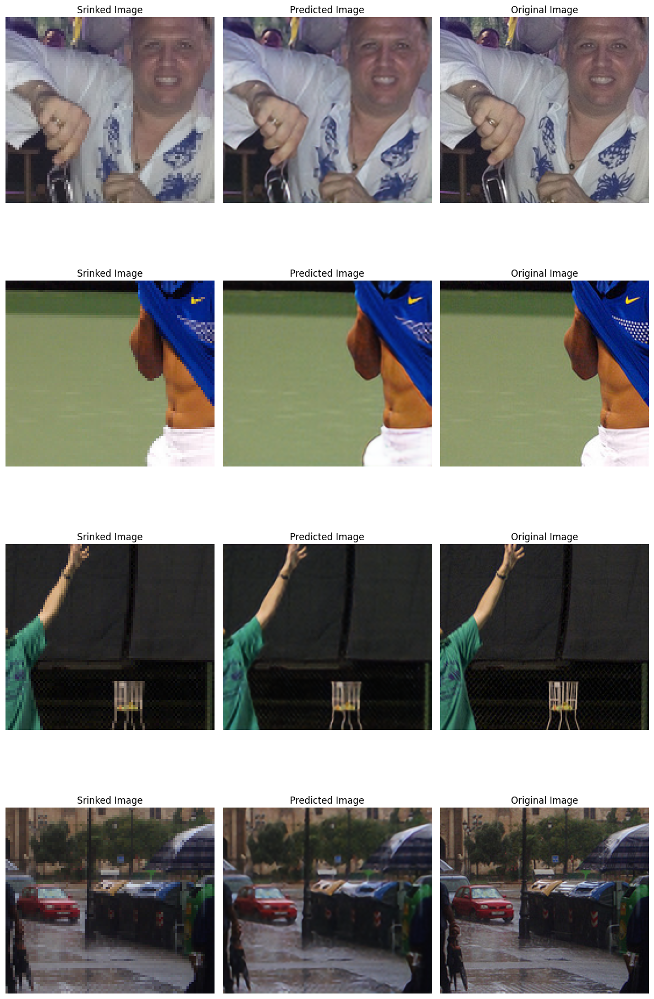


EPOCH [19/20]


100%|██████████| 80/80 [00:07<00:00, 11.13it/s, Epoch=19, Train_Loss=0.00286]


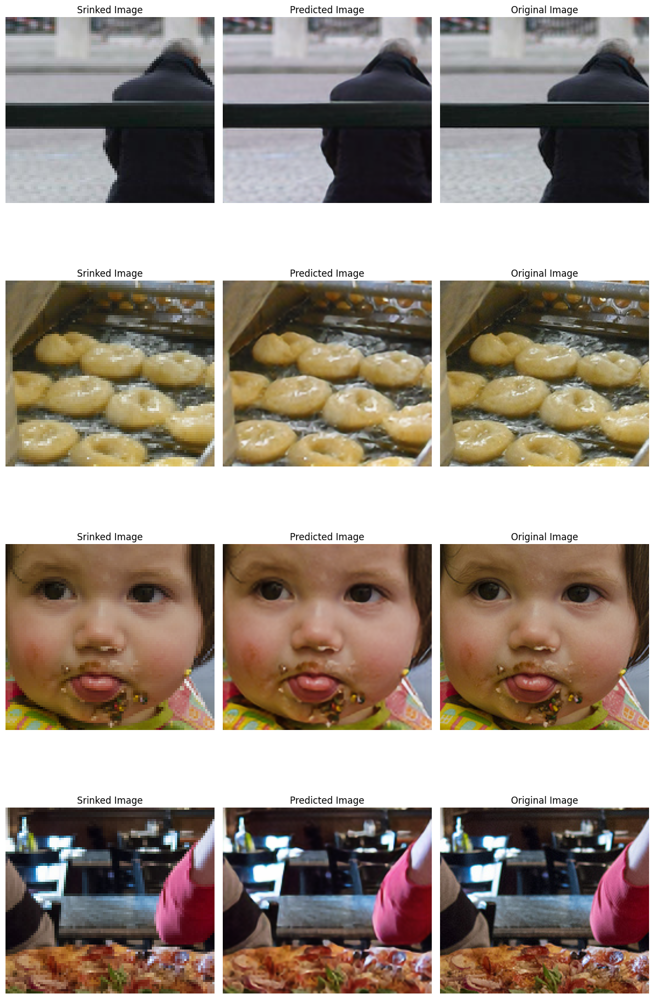


EPOCH [20/20]


100%|██████████| 80/80 [00:07<00:00, 10.82it/s, Epoch=20, Train_Loss=0.00293]


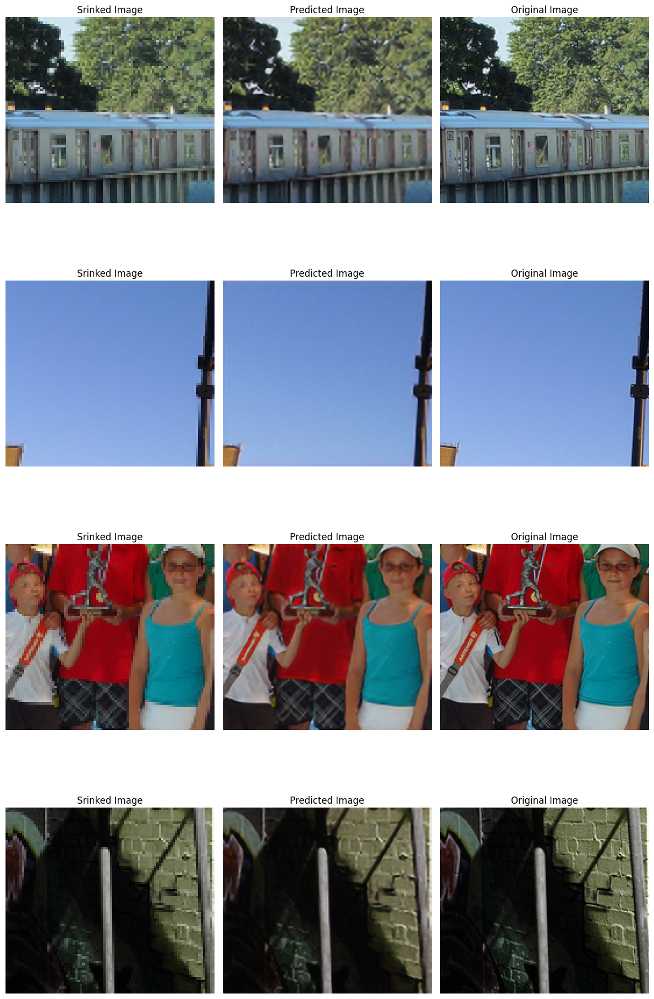


Training complete in 1h 6m 8s
Best LOSS: 0.00%


In [45]:
high_resolution_model, history = run_training(
    high_resolution_model,
    optimizer,
    scheduler,
    device=device,
    num_epochs=20
)

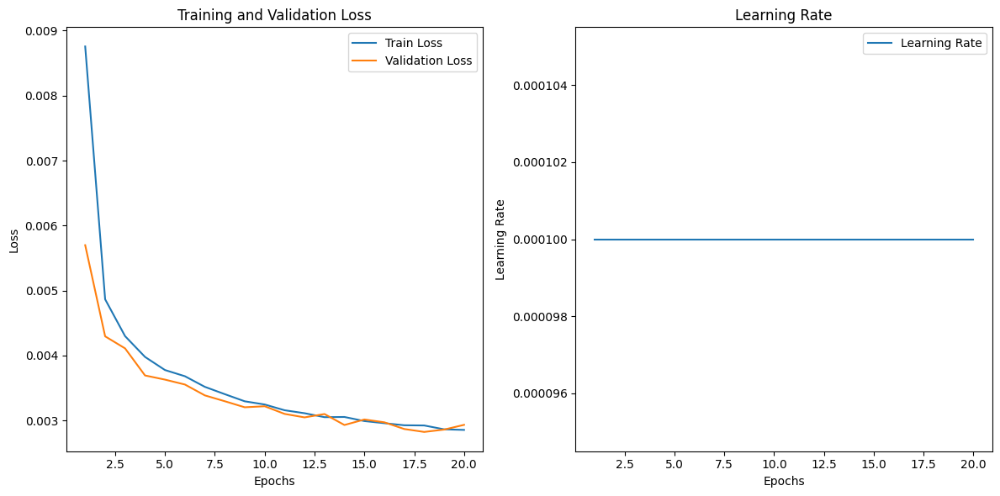

In [46]:
# %%
def plot_training_metrics(history):
    epochs = range(1, len(history['Train Loss']) + 1)

    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, history['Train Loss'], label='Train Loss')
    plt.plot(epochs, history['Valid Loss'], label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, history['lr'], label='Learning Rate')
    plt.xlabel('Epochs')
    plt.ylabel('Learning Rate')
    plt.title('Learning Rate')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Call this function to plot training metrics
plot_training_metrics(history)
